# Ensemble 2: gravity spacings vs noise; no regional field

import packages

In [1]:
from __future__ import annotations

%load_ext autoreload
%autoreload 2
import itertools
import logging
import os
import pathlib
import pickle

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pygmt
import scipy
import verde as vd
import xarray as xr
from polartoolkit import fetch, maps
from polartoolkit import utils as polar_utils
from tqdm.autonotebook import tqdm

import synthetic_bathymetry_inversion.plotting as synth_plotting
from synthetic_bathymetry_inversion import synthetic

os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

logging.getLogger().setLevel(logging.INFO)

from invert4geom import inversion, plotting, regional, utils
from invert4geom import synthetic as inv_synthetic

/home/mattd/miniforge3/envs/synthetic_bathymetry_inversion/lib/python3.12/site-packages/esmpy/interface/loadESMF.py:94: VersionWarning:

ESMF installation version 8.8.0, ESMPy version 8.8.0b0



In [2]:
ensemble_path = "../results/Ross_Sea/ensembles/Ross_Sea_ensemble_02_grav_spacing_vs_noise_0_3_no_regional_with_density_estimation"
ensemble_fname = f"{ensemble_path}.csv"

INFO:polartoolkit:converting to be reference to the WGS84 ellipsoid
INFO:polartoolkit:spacing larger than original, filtering and resampling
grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


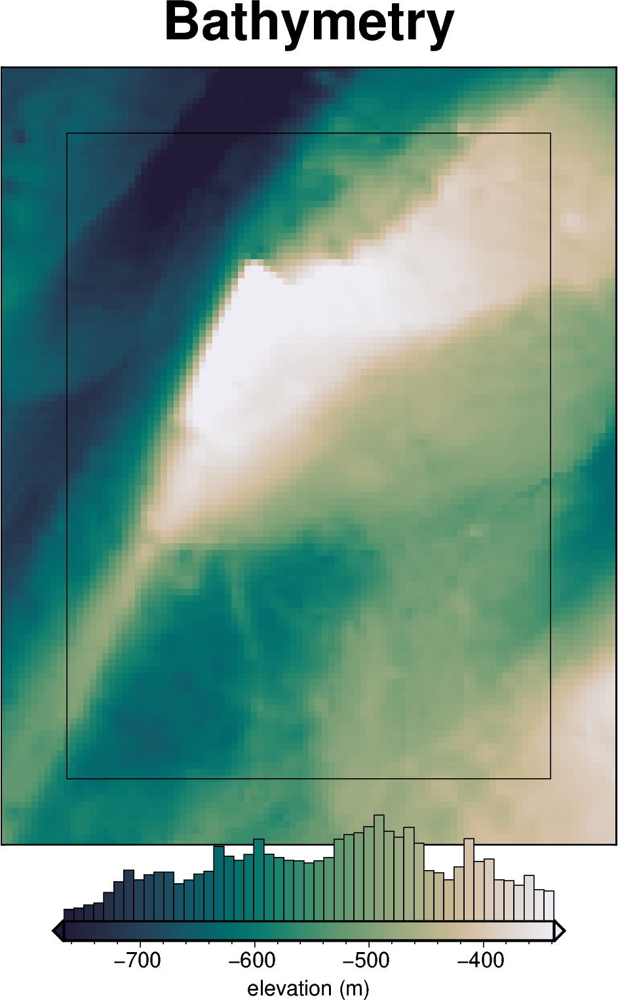

  0%|          | 0/7676 [00:00<?, ?it/s]

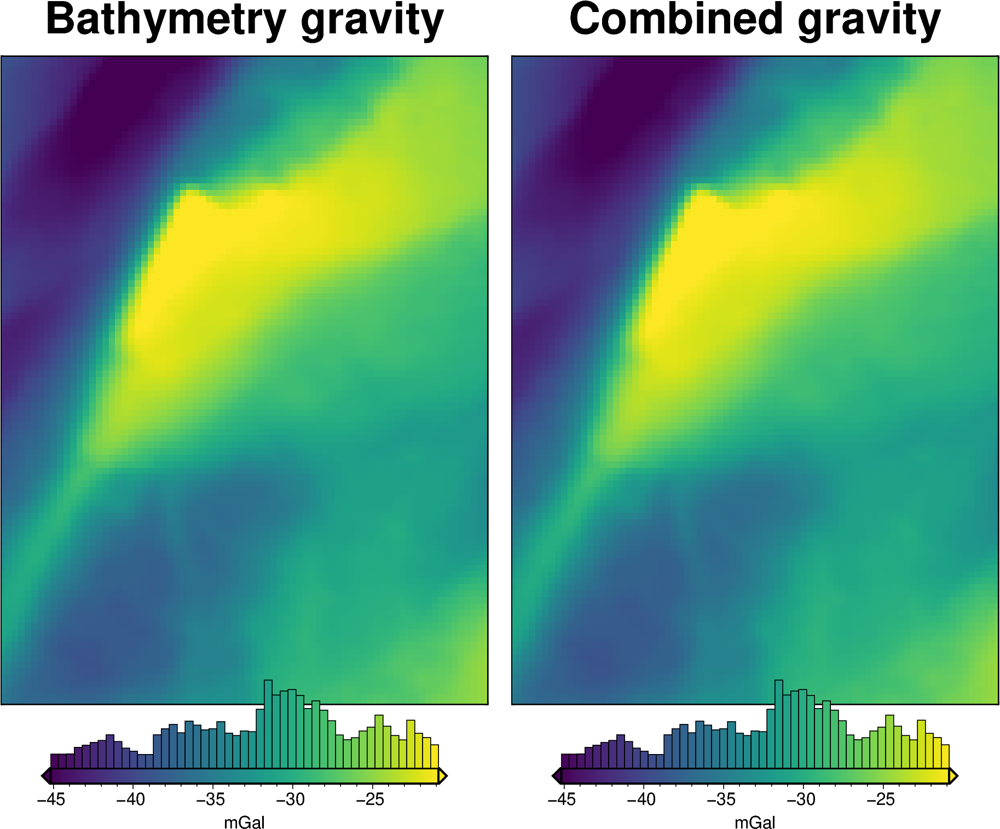

In [3]:
# set grid parameters
spacing = 2e3
inversion_region = (-40e3, 110e3, -1600e3, -1400e3)

true_density_contrast = 1476

bathymetry, _, original_grav_df = synthetic.load_synthetic_model(
    spacing=spacing,
    inversion_region=inversion_region,
    buffer=spacing * 10,
    basement=False,
    zref=0,
    bathymetry_density_contrast=true_density_contrast,
)
buffer_region = polar_utils.get_grid_info(bathymetry)[1]

In [4]:
bathymetry = bathymetry.sel(
    easting=slice(inversion_region[0], inversion_region[1]),
    northing=slice(inversion_region[2], inversion_region[3]),
)

In [5]:
original_grav_df = original_grav_df.drop(columns=["basement_grav", "disturbance"])
original_grav_df = original_grav_df.rename(
    columns={"gravity_anomaly": "gravity_anomaly_full_res_no_noise"},
)
original_grav_df

,northing,easting,upward,bathymetry_grav,gravity_anomaly_full_res_no_noise
0,-1600000.0,-40000.0,1000.0,-35.551041,-35.551041
1,-1600000.0,-38000.0,1000.0,-36.054652,-36.054652
2,-1600000.0,-36000.0,1000.0,-36.473148,-36.473148
3,-1600000.0,-34000.0,1000.0,-36.755612,-36.755612
4,-1600000.0,-32000.0,1000.0,-36.951032,-36.951032
...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760380,-25.760380
7672,-1400000.0,104000.0,1000.0,-25.911731,-25.911731
7673,-1400000.0,106000.0,1000.0,-26.033127,-26.033127
7674,-1400000.0,108000.0,1000.0,-26.122232,-26.122232


In [6]:
# semi-regularly spaced
constraint_points = synthetic.constraint_layout_number(
    shape=(6, 7),
    region=inversion_region,
    padding=-spacing,
    shapefile="../results/Ross_Sea_outline.shp",
    add_outside_points=True,
    grid_spacing=spacing,
)

# sample true topography at these points
constraint_points = utils.sample_grids(
    constraint_points,
    bathymetry,
    "true_upward",
    coord_names=("easting", "northing"),
)
constraint_points["upward"] = constraint_points.true_upward
constraint_points.head()

,northing,easting,inside,true_upward,upward
0,-1600000.0,-40000.0,False,-601.093811,-601.093811
1,-1600000.0,-38000.0,False,-609.216797,-609.216797
2,-1600000.0,-36000.0,False,-616.356018,-616.356018
3,-1600000.0,-34000.0,False,-621.262207,-621.262207
4,-1600000.0,-32000.0,False,-625.510864,-625.510864


In [7]:
# calculate gravity data median distance
grd = bathymetry.sel(
    easting=slice(*inversion_region[:2]), northing=slice(*inversion_region[2:])
)

grd = fetch.resample_grid(grd, spacing=100, verbose="q").rename(
    {"x": "easting", "y": "northing"}
)

min_dist = utils.dist_nearest_points(
    constraint_points,
    grd,
).min_dist
print(f"Median constraint proximity overall: {int(min_dist.median().values)} m")

# mask to the ice shelf outline
min_dist = polar_utils.mask_from_shp(
    shapefile="../results/Ross_Sea_outline.shp",
    xr_grid=min_dist,
    invert=False,
    masked=True,
)

print(f"median minimum proximity inside: {int(min_dist.median().values)} m")

Median constraint proximity overall: 7978 m
median minimum proximity inside: 8557 m


In [8]:
# grid the sampled values using verde
starting_topography_kwargs = dict(
    method="splines",
    region=buffer_region,
    spacing=spacing,
    constraints_df=constraint_points,
    dampings=None,
)

starting_bathymetry = utils.create_topography(**starting_topography_kwargs)

starting_bathymetry

<xarray.DataArray 'scalars' (northing: 121, easting: 96)> Size: 93kB
array([[-541.24376756, -544.57145532, -547.92259611, ..., -360.00002858,
        -357.06763298, -354.19952961],
       [-543.34365606, -546.81640129, -550.35222196, ..., -362.90249581,
        -359.9686979 , -357.11426816],
       [-545.05496589, -548.66001145, -552.37483947, ..., -365.66133989,
        -362.73264883, -359.9004747 ],
       ...,
       [-591.95330238, -595.5187825 , -599.06866788, ..., -440.89364102,
        -440.6949685 , -440.40606698],
       [-590.53129825, -594.09072645, -597.64076241, ..., -440.69206448,
        -440.42575788, -440.07250027],
       [-589.16627634, -592.73500682, -596.3020645 , ..., -440.51808973,
        -440.17189745, -439.74486709]])
Coordinates:
  * easting   (easting) float64 768B -6e+04 -5.8e+04 ... 1.28e+05 1.3e+05
  * northing  (northing) float64 968B -1.62e+06 -1.618e+06 ... -1.38e+06
Attributes:
    metadata:  Generated by SplineCV(cv=KFold(n_splits=5, random_state=0, shu...
    damping:   None

In [9]:
inner_starting_bathymetry = starting_bathymetry.sel(
    easting=slice(inversion_region[0], inversion_region[1]),
    northing=slice(inversion_region[2], inversion_region[3]),
)

starting_bathymetry_rmse = utils.rmse(bathymetry - inner_starting_bathymetry)

In [10]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    starting_bathymetry,
    "starting_bathymetry",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.true_upward - constraint_points.starting_bathymetry)
print(f"RMSE: {rmse:.2f} m")

RMSE: 0.03 m


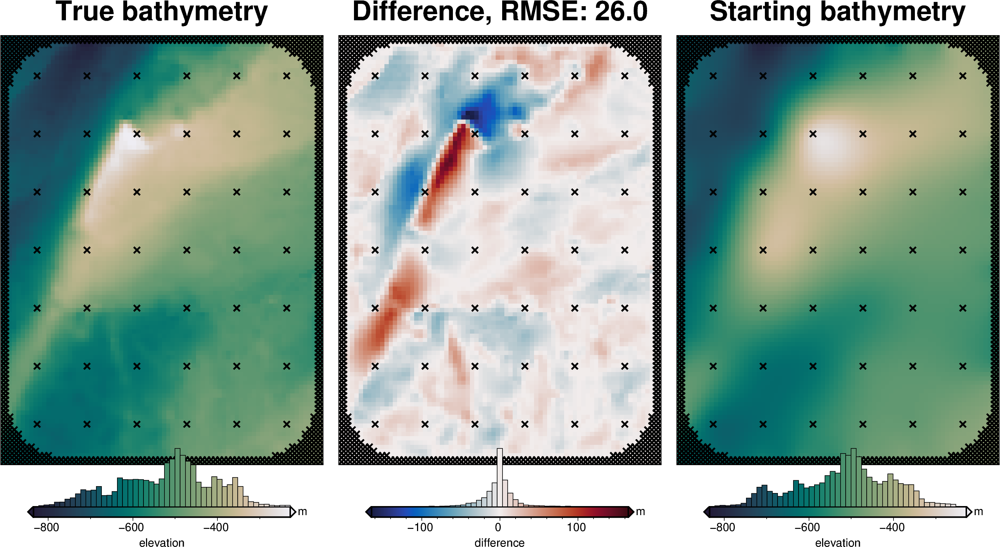

In [11]:
# compare starting and actual bathymetry grids
grids = polar_utils.grd_compare(
    bathymetry,
    starting_bathymetry,
    fig_height=10,
    plot=True,
    plot_type="pygmt",
    cmap="rain",
    reverse_cpt=True,
    diff_cmap="balance+h0",
    grid1_name="True bathymetry",
    grid2_name="Starting bathymetry",
    title="Difference",
    title_font="18p,Helvetica-Bold,black",
    cbar_unit="m",
    cbar_label="elevation",
    RMSE_decimals=0,
    region=inversion_region,
    inset=False,
    hist=True,
    cbar_yoffset=1,
    label_font="16p,Helvetica,black",
    points=constraint_points.rename(columns={"easting": "x", "northing": "y"}),
    points_style="x.2c",
)

In [12]:
# delete files if already exist
for p in pathlib.Path().glob(f"{ensemble_path}_starting_bathymetry.nc"):
    p.unlink(missing_ok=True)

# save to file
starting_bathymetry.drop_attrs().to_netcdf(
    f"{ensemble_path}_starting_bathymetry.nc",
)
constraint_points.to_csv(f"{ensemble_path}_constraint_points.csv", index=False)

In [13]:
# the true density contrast is 1476 kg/m3
density_contrast = 1476

# set the reference level from the prisms to 0
zref = 0

density_grid = xr.where(
    starting_bathymetry >= zref,
    density_contrast,
    -density_contrast,
)

# create layer of prisms
starting_prisms = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)

original_grav_df["starting_gravity"] = starting_prisms.prism_layer.gravity(
    coordinates=(
        original_grav_df.easting,
        original_grav_df.northing,
        original_grav_df.upward,
    ),
    field="g_z",
    progressbar=True,
)

original_grav_df

  0%|          | 0/7676 [00:00<?, ?it/s]

,northing,easting,upward,bathymetry_grav,gravity_anomaly_full_res_no_noise,starting_gravity
0,-1600000.0,-40000.0,1000.0,-35.551041,-35.551041,-35.578552
1,-1600000.0,-38000.0,1000.0,-36.054652,-36.054652,-36.042636
2,-1600000.0,-36000.0,1000.0,-36.473148,-36.473148,-36.460093
3,-1600000.0,-34000.0,1000.0,-36.755612,-36.755612,-36.784646
4,-1600000.0,-32000.0,1000.0,-36.951032,-36.951032,-36.998466
...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760380,-25.760380,-25.498181
7672,-1400000.0,104000.0,1000.0,-25.911731,-25.911731,-25.673783
7673,-1400000.0,106000.0,1000.0,-26.033127,-26.033127,-25.808796
7674,-1400000.0,108000.0,1000.0,-26.122232,-26.122232,-25.904539


# Set line spacings and noise levels

In [14]:
num = 10

# Define number of flights lines on log scale
grav_line_numbers = np.unique(np.round(np.geomspace(3, 30, num)))
grav_line_numbers = [int(i) for i in grav_line_numbers]
assert len(grav_line_numbers) == num

# Define noise levels for grav data
grav_noise_levels = [float(round(x, 2)) for x in np.linspace(0, 3, num)]

print("number of grav lines:", grav_line_numbers)
print("grav noise levels:", grav_noise_levels)

number of grav lines: [3, 4, 5, 6, 8, 11, 14, 18, 23, 30]
grav noise levels: [0.0, 0.33, 0.67, 1.0, 1.33, 1.67, 2.0, 2.33, 2.67, 3.0]


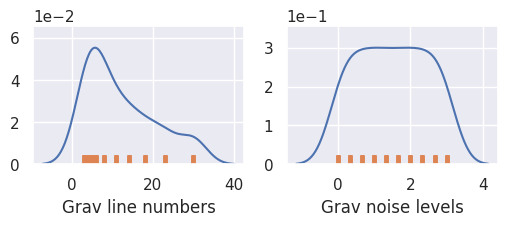

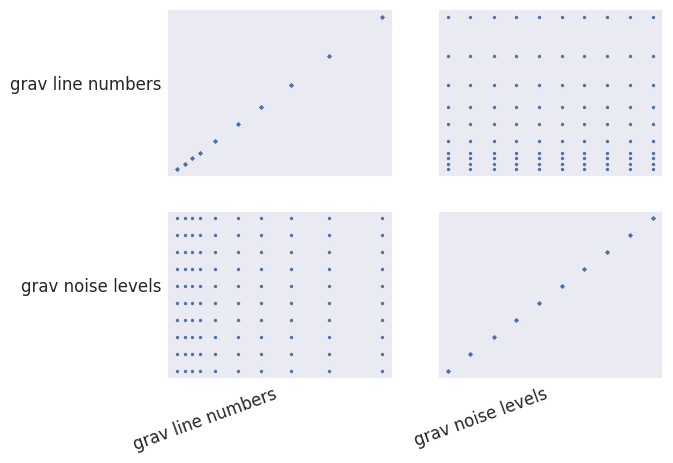

In [14]:
# turn into dataframe
sampled_params_df = pd.DataFrame(
    itertools.product(
        grav_line_numbers,
        grav_noise_levels,
    ),
    columns=[
        "grav_line_numbers",
        "grav_noise_levels",
    ],
)

sampled_params_dict = dict(
    grav_line_numbers=dict(sampled_values=sampled_params_df.grav_line_numbers),
    grav_noise_levels=dict(sampled_values=sampled_params_df.grav_noise_levels),
)

plotting.plot_latin_hypercube(
    sampled_params_dict,
)

In [15]:
sampled_params_df

,grav_line_numbers,grav_noise_levels
0,3,0.00
1,3,0.33
2,3,0.67
3,3,1.00
4,3,1.33
...,...,...
95,30,1.67
96,30,2.00
97,30,2.33
98,30,2.67


# Contaminate gravity with noise

In [ ]:
# fnames to save files for each ensemble
sampled_params_df["grav_df_fname"] = pd.Series()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # set file names, add to dataframe
    sampled_params_df.loc[i, "grav_df_fname"] = f"{ensemble_path}_grav_df_{i}.csv"

  0%|          | 0/100 [00:00<?, ?it/s]

In [17]:
grav_grid = original_grav_df.set_index(["northing", "easting"]).to_xarray()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    grav_df = original_grav_df.copy()

    # contaminated with long-wavelength noise
    grav_df["gravity_anomaly_full_res"] = grav_df.gravity_anomaly_full_res_no_noise
    with utils._log_level(logging.ERROR):
        contaminated = inv_synthetic.contaminate_with_long_wavelength_noise(
            grav_grid.gravity_anomaly_full_res_no_noise,
            coarsen_factor=None,
            spacing=2e3,
            noise_as_percent=False,
            noise=row.grav_noise_levels,
        )
    contaminated_df = vd.grid_to_table(
        contaminated.rename("gravity_anomaly_full_res")
    ).reset_index(drop=True)

    grav_df = pd.merge(  # noqa: PD015
        grav_df.drop(columns=["gravity_anomaly_full_res"], errors="ignore"),
        contaminated_df,
        on=["easting", "northing"],
    )

    # # short-wavelength noise
    # with utils._log_level(logging.ERROR):
    #     contaminated = synthetic.contaminate_with_long_wavelength_noise(
    #         grav_df.set_index(["northing", "easting"])
    #         .to_xarray()
    #         .gravity_anomaly_full_res,
    #         coarsen_factor=None,
    #         spacing=spacing * 2,
    #         noise_as_percent=False,
    #         noise=row.grav_noise_levels,
    #     )
    # contaminated_df = vd.grid_to_table(
    #     contaminated.rename("gravity_anomaly_full_res")
    # ).reset_index(drop=True)

    # grav_df = pd.merge(
    #     grav_df.drop(columns=["gravity_anomaly_full_res"], errors="ignore"),
    #     contaminated_df,
    #     on=["easting", "northing"],
    # )

    # add noise level to uncert column
    grav_df["uncert"] = row.grav_noise_levels

    # save to files
    grav_df.to_csv(row.grav_df_fname, index=False)

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning origin

,grav_line_numbers,grav_noise_levels,grav_df_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


In [18]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [19]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


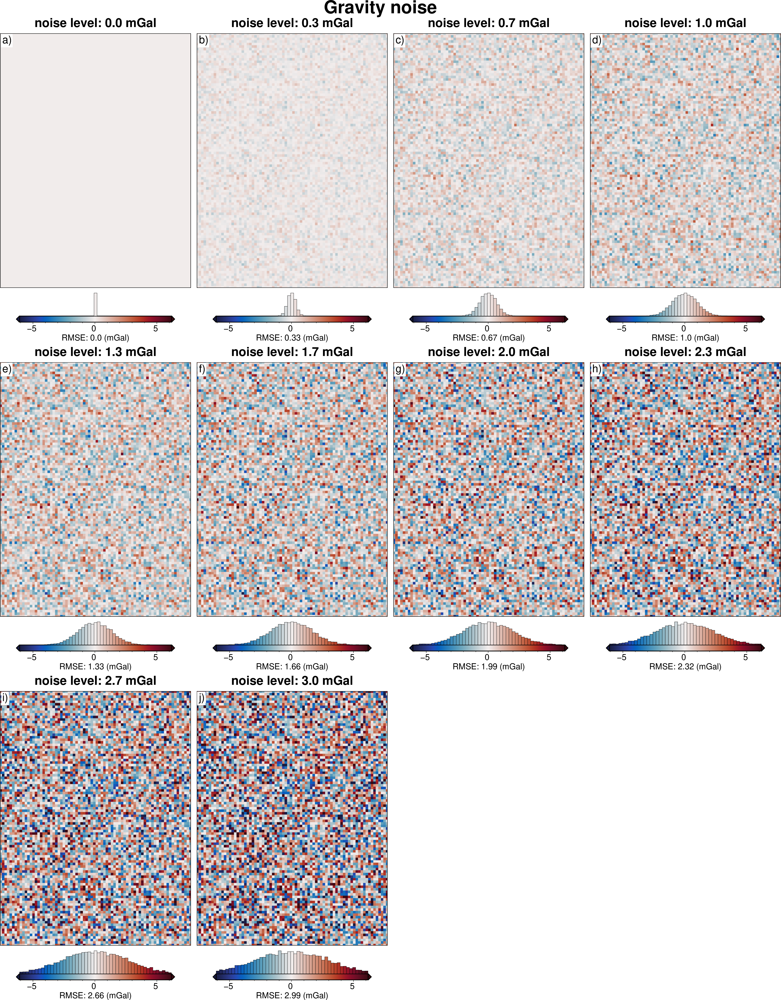

In [20]:
# subplots showing grav data loss from sampling
grids = []
titles = []
cbar_labels = []
for i, row in sampled_params_df.iterrows():
    if i < num:
        grav_df = pd.read_csv(row.grav_df_fname)
        grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
        dif = (
            grav_grid.gravity_anomaly_full_res_no_noise
            - grav_grid.gravity_anomaly_full_res
        )
        # add to lists
        grids.append(dif)
        titles.append(f"noise level: {round(row.grav_noise_levels,1)} mGal")
        cbar_labels.append(f"RMSE: {round(utils.rmse(dif),2)} (mGal)")

fig = maps.subplots(
    grids,
    fig_title="Gravity noise",
    titles=titles,
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    hist=True,
    cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cbar_font="18p,Helvetica,black",
)

fig.show()

# Sample along flightlines

In [ ]:
# fnames to save files for each ensemble
sampled_params_df["grav_survey_df_fname"] = pd.Series()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # set file names, add to dataframe
    sampled_params_df.loc[i, "grav_survey_df_fname"] = (
        f"{ensemble_path}_grav_survey_df_{i}.csv"
    )

  0%|          | 0/100 [00:00<?, ?it/s]

In [23]:
logging.getLogger().setLevel(logging.WARNING)

# add empty columns
# average of the east/west and north/south line spacings
sampled_params_df["grav_line_spacing"] = pd.Series()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    # create flight lines
    grav_survey_df = synthetic.airborne_survey(
        along_line_spacing=500,
        grav_observation_height=1e3,
        ns_line_number=row.grav_line_numbers,
        ew_line_number=row.grav_line_numbers,
        region=inversion_region,
        grav_grid=grav_df.set_index(["northing", "easting"])
        .to_xarray()
        .gravity_anomaly_full_res,
        plot=False,
    )
    x_spacing = (inversion_region[1] - inversion_region[0]) / row.grav_line_numbers
    y_spacing = (inversion_region[3] - inversion_region[2]) / row.grav_line_numbers
    grav_line_spacing = ((x_spacing + y_spacing) / 2) / 1e3

    # sample no-noise grid onto survey lines
    grav_survey_df = utils.sample_grids(
        grav_survey_df,
        grav_df.set_index(
            ["northing", "easting"]
        ).gravity_anomaly_full_res_no_noise.to_xarray(),
        sampled_name="gravity_anomaly_no_noise",
    )

    # add to dataframe
    sampled_params_df.loc[i, "grav_line_spacing"] = grav_line_spacing

    # save to files
    grav_survey_df.to_csv(row.grav_survey_df_fname, index=False)


sampled_params_df

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333
...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333


In [17]:
for i, row in sampled_params_df.iterrows():
    # load data
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)

    # calc min distance
    coords = vd.grid_coordinates(
        region=inversion_region,
        spacing=100,
    )
    grid = vd.make_xarray_grid(coords, np.ones_like(coords[0]), data_names="z").z
    min_dist = (
        utils.dist_nearest_points(
            grav_survey_df,
            grid,
        ).min_dist
        / 1e3
    )
    sampled_params_df.loc[i, "grav_proximity"] = min_dist.median()
    sampled_params_df.loc[i, "grav_proximity_skew"] = scipy.stats.skew(
        min_dist.values.ravel(), nan_policy="omit"
    )

(
    sampled_params_df.grav_proximity.describe(),
    sampled_params_df.grav_proximity_skew.describe(),
)

(count    100.000000
 mean       3.430303
 std        2.368128
 min        0.824621
 25%        1.400000
 50%        2.704055
 75%        5.001000
 max        8.333333
 Name: grav_proximity, dtype: float64,
 count    100.000000
 mean       0.504258
 std        0.015236
 min        0.489544
 25%        0.491777
 50%        0.498486
 75%        0.513887
 max        0.537052
 Name: grav_proximity_skew, dtype: float64)

In [18]:
w = np.abs(inversion_region[1] - inversion_region[0]) / 1e3
h = np.abs(inversion_region[3] - inversion_region[2]) / 1e3
w, h

(150.0, 200.0)

In [19]:
sampled_params_df["flight_kms"] = pd.Series()
for i, row in sampled_params_df.iterrows():
    survey_df = pd.read_csv(row.grav_survey_df_fname)
    # flight km is length of lines in km X number of lines
    sampled_params_df.loc[i, "flight_kms"] = (
        w * row.grav_line_numbers + h * row.grav_line_numbers
    )
sampled_params_df.flight_kms.unique()

array([1050.0, 1400.0, 1750.0, 2100.0, 2800.0, 3850.0, 4900.0, 6300.0,
       8050.0, 10500.0], dtype=object)

In [20]:
inversion_area = (
    (inversion_region[1] - inversion_region[0])
    / 1e3
    * (inversion_region[3] - inversion_region[2])
    / 1e3
)
sampled_params_df["flight_kms_per_10000sq_km"] = (
    (sampled_params_df.flight_kms / inversion_area) * 10e3
).astype(float)
sampled_params_df.flight_kms_per_10000sq_km.unique()

array([ 350.        ,  466.66666667,  583.33333333,  700.        ,
        933.33333333, 1283.33333333, 1633.33333333, 2100.        ,
       2683.33333333, 3500.        ])

Text(0, 0.5, 'grav_proximity')

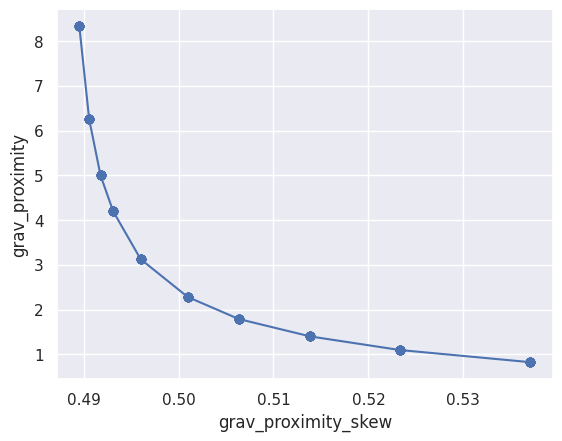

In [32]:
df = sampled_params_df
y = "grav_proximity"
x = "grav_proximity_skew"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

Text(0, 0.5, 'grav_proximity')

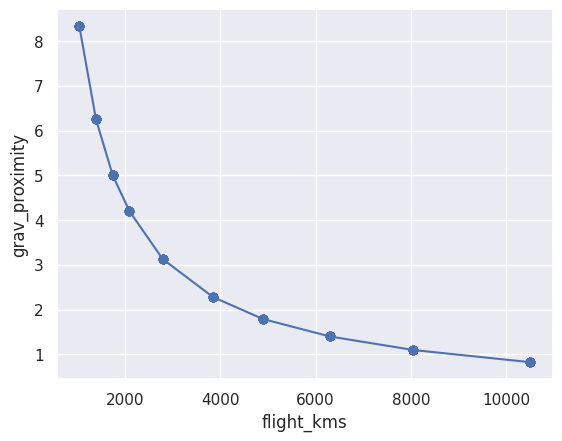

In [33]:
df = sampled_params_df
y = "grav_proximity"
x = "flight_kms"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

Text(0, 0.5, 'grav_proximity_skew')

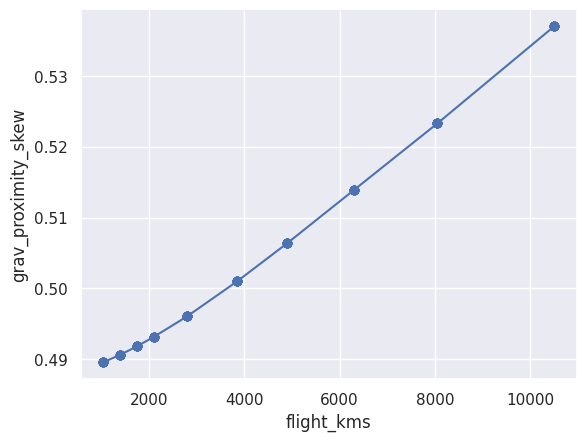

In [34]:
df = sampled_params_df
y = "grav_proximity_skew"
x = "flight_kms"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

# Filter flight line data

In [ ]:
# add empty columns
sampled_params_df["filter_width_trials_fname"] = np.nan

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # set file names, add to dataframe
    sampled_params_df.loc[i, "filter_width_trials_fname"] = (
        f"{ensemble_path}_filter_width_trials_{i}.csv"
    )

  0%|          | 0/100 [00:00<?, ?it/s]

In [25]:
logging.getLogger().setLevel(logging.WARNING)

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)

    # trial a range of 1D low-pass filters and see which performs best
    dfs = []
    filter_widths = np.arange(0, 50e3, 4e3)
    for f in filter_widths:
        survey_df = grav_survey_df.copy()

        if f == 0:
            survey_df["grav_anomaly_filt"] = survey_df.gravity_anomaly
        else:
            survey_df["grav_anomaly_filt"] = synthetic.filter_flight_lines(
                survey_df,
                data_column="gravity_anomaly",
                filt_type=f"g{f}",
            )

        # compared filtered line data with no-noise line data
        survey_df["dif"] = (
            survey_df.gravity_anomaly_no_noise - survey_df.grav_anomaly_filt
        )

        dfs.append(
            pd.DataFrame(
                [
                    {
                        "filt_width": f,
                        "rmse": utils.rmse(survey_df.dif),
                    }
                ]
            )
        )

    filter_width_trials = pd.concat(dfs, ignore_index=True)

    # save to files
    filter_width_trials.to_csv(row.filter_width_trials_fname, index=False)


sampled_params_df

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0
...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,32000.0
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,36000.0
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,36000.0


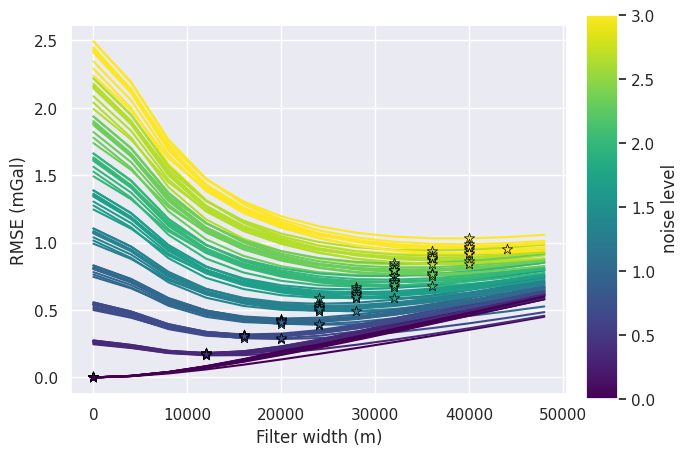

In [26]:
# add empty columns
sampled_params_df["best_filter_width"] = np.nan

norm = plt.Normalize(
    vmin=sampled_params_df.grav_noise_levels.values.min(),
    vmax=sampled_params_df.grav_noise_levels.values.max(),
)
for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    filter_width_trials = pd.read_csv(row.filter_width_trials_fname)

    best_ind = filter_width_trials.rmse.idxmin()
    best_filter_width = filter_width_trials.iloc[best_ind].filt_width

    if i == 0:
        fig, ax = plt.subplots()

    ax.plot(
        filter_width_trials.filt_width,
        filter_width_trials.rmse,
        color=plt.cm.viridis(norm(row.grav_noise_levels)),  # pylint: disable=no-member
    )
    ax.set_xlabel("Filter width (m)")
    ax.set_ylabel("RMSE (mGal)")
    ax.scatter(
        x=filter_width_trials.filt_width.iloc[best_ind],
        y=filter_width_trials.rmse.iloc[best_ind],
        marker="*",
        edgecolor="black",
        linewidth=0.5,
        color=plt.cm.viridis(norm(row.grav_noise_levels)),  # pylint: disable=no-member
        s=60,
        zorder=20,
    )

    sampled_params_df.loc[i, "best_filter_width"] = best_filter_width

sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
cax = fig.add_axes([0.93, 0.1, 0.05, 0.8])
cbar = plt.colorbar(sm, cax=cax)
cbar.set_label("noise level")

sampled_params_df

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0
...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,32000.0
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,36000.0
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,36000.0


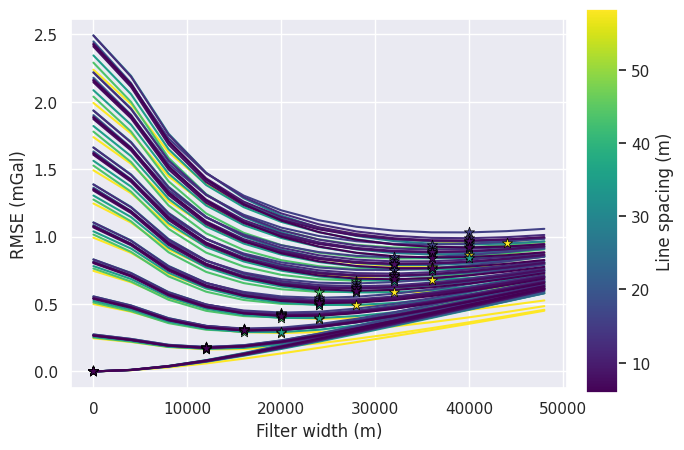

In [27]:
# variable = grav_noise_levels
# title = "Gravity noise (mGal)"

variable = "grav_line_spacing"
title = "Line spacing (m)"

norm = plt.Normalize(
    vmin=sampled_params_df[variable].values.min(),
    vmax=sampled_params_df[variable].values.max(),
)
for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    filter_width_trials = pd.read_csv(row.filter_width_trials_fname)

    best_ind = filter_width_trials.rmse.idxmin()
    best_filter_width = filter_width_trials.iloc[best_ind].filt_width

    if i == 0:
        fig, ax = plt.subplots()

    ax.plot(
        filter_width_trials.filt_width,
        filter_width_trials.rmse,
        color=plt.cm.viridis(norm(row[variable])),  # pylint: disable=no-member
    )
    ax.set_xlabel("Filter width (m)")
    ax.set_ylabel("RMSE (mGal)")
    ax.scatter(
        x=filter_width_trials.filt_width.iloc[best_ind],
        y=filter_width_trials.rmse.iloc[best_ind],
        marker="*",
        edgecolor="black",
        linewidth=0.5,
        color=plt.cm.viridis(norm(row[variable])),  # pylint: disable=no-member
        s=60,
        zorder=20,
    )

sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
cax = fig.add_axes([0.93, 0.1, 0.05, 0.8])
cbar = plt.colorbar(sm, cax=cax)
cbar.set_label(title)

sampled_params_df

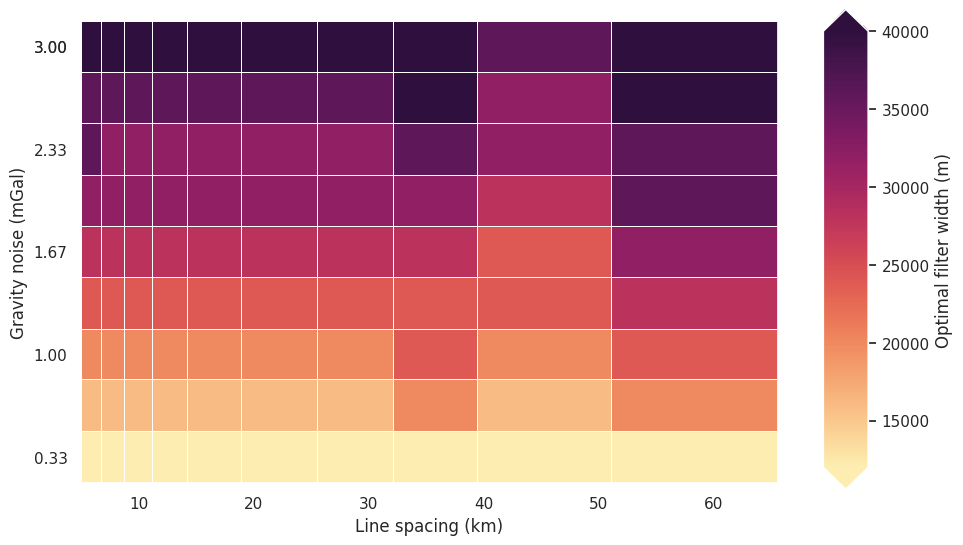

In [28]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df[sampled_params_df.grav_noise_levels > 0],
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="best_filter_width",
    background_title="Optimal filter width (m)",
    background_robust=True,
    constrained_layout=False,
)

<Axes: ylabel='Frequency'>

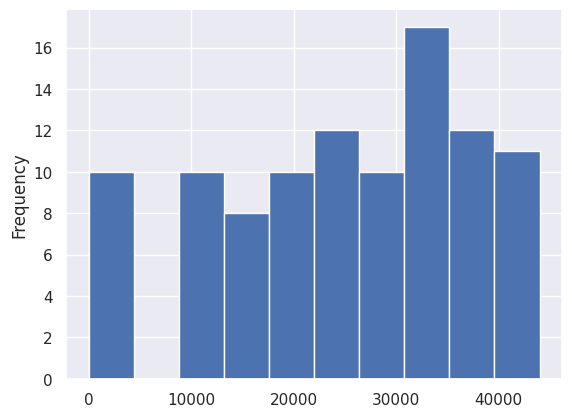

In [29]:
sampled_params_df.best_filter_width.plot.hist()

In [30]:
logging.getLogger().setLevel(logging.WARNING)

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)

    # filter each line in 1D with a Gaussian filter to remove some noise
    if row.best_filter_width == 0:
        grav_survey_df["gravity_anomaly"] = grav_survey_df.gravity_anomaly
    else:
        grav_survey_df["gravity_anomaly"] = synthetic.filter_flight_lines(
            grav_survey_df,
            data_column="gravity_anomaly",
            filt_type=f"g{row.best_filter_width}",
        )

    # save to files
    grav_survey_df.to_csv(row.grav_survey_df_fname, index=False)

  0%|          | 0/100 [00:00<?, ?it/s]

# Interpolate flight line data

In [31]:
logging.getLogger().setLevel(logging.WARNING)

# add empty columns
sampled_params_df["grav_data_loss_rmse"] = np.nan
sampled_params_df["grav_data_loss_mae"] = np.nan

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)

    grav_grid = pygmt.surface(
        data=grav_survey_df[["easting", "northing", "gravity_anomaly"]],
        region=inversion_region,
        spacing=spacing,
        tension=0.25,
        verbose="q",
    )
    grav_df = utils.sample_grids(
        grav_df,
        grav_grid,
        sampled_name="gravity_anomaly",
    )

    # add to dataframe
    dif = grav_df.gravity_anomaly_full_res_no_noise - grav_df.gravity_anomaly
    sampled_params_df.loc[i, "grav_data_loss_rmse"] = float(utils.rmse(dif))
    sampled_params_df.loc[i, "grav_data_loss_mae"] = float(np.abs(dif).mean())

    # save to files
    grav_survey_df.to_csv(row.grav_survey_df_fname, index=False)
    grav_df.to_csv(row.grav_df_fname, index=False)

sampled_params_df

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,2.103455,1.163585
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,2.110869,1.185500
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,2.126528,1.217493
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0,2.140210,1.246192
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,2.158392,1.278125
...,...,...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,0.540889,0.417036
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,32000.0,0.615372,0.471538
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,36000.0,0.687653,0.523959
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,36000.0,0.755164,0.579798


In [32]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [33]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,2.103455,1.163585
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,2.110869,1.185500
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,2.126528,1.217493
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0,2.140210,1.246192
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,2.158392,1.278125


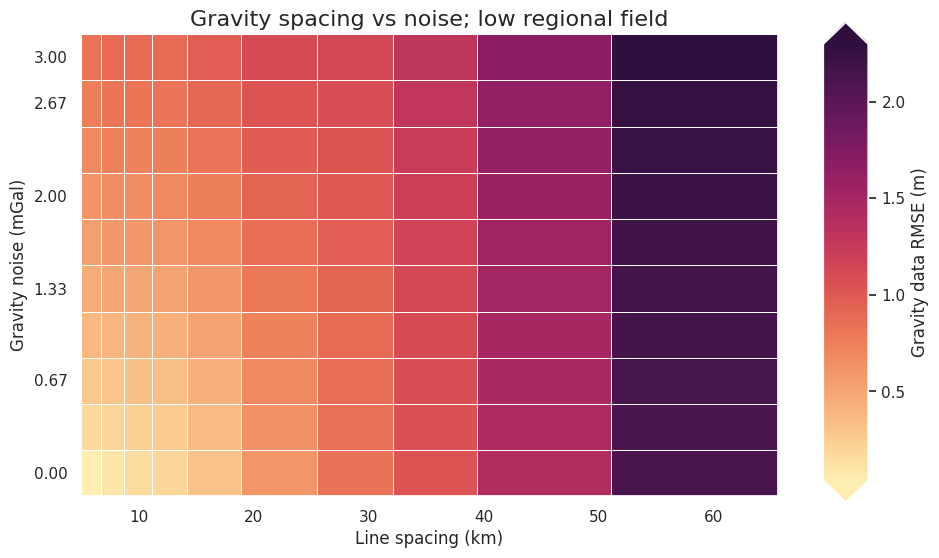

In [34]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="grav_data_loss_rmse",
    background_title="Gravity data RMSE (m)",
    plot_title="Gravity spacing vs noise; low regional field",
    constrained_layout=False,
)

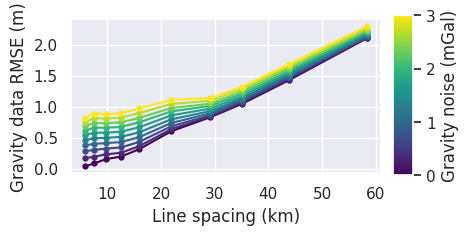

In [35]:
x = "grav_line_spacing"
fig = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    figsize=(4, 2),
    x=x,
    x_label="Line spacing (km)",
    y="grav_data_loss_rmse",
    y_label="Gravity data RMSE (m)",
    groupby_col="grav_noise_levels",
    cbar_label="Gravity noise (mGal)",
    # logx=True,
)

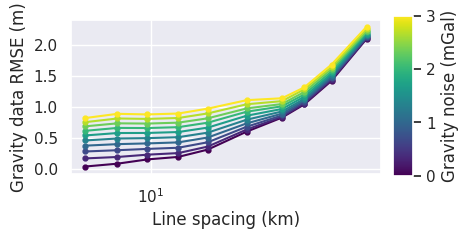

In [36]:
x = "grav_line_spacing"
fig = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    figsize=(4, 2),
    x=x,
    x_label="Line spacing (km)",
    y="grav_data_loss_rmse",
    y_label="Gravity data RMSE (m)",
    groupby_col="grav_noise_levels",
    cbar_label="Gravity noise (mGal)",
    logx=True,
)

In [37]:
# subplots showing grav data loss from sampling and noise
grids = []
cbar_labels = []
row_titles = []
column_titles = []
surveys = []

# iterate over the ensemble starting with high noise, low line numbers
# row per noise level and column per line spacing
for i, row in sampled_params_df.sort_values(
    by=["grav_noise_levels", "grav_line_spacing"],
    ascending=False,
).iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
    dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly
    # add to lists
    grids.append(dif)
    cbar_labels.append(f"RMSE:{round(utils.rmse(dif),2)}")
    if i % num == 0:
        column_titles.append(round(row.grav_line_spacing))
    if i < num:
        row_titles.append(round(row.grav_noise_levels, 1))
    # get survey points
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)
    surveys.append(grav_survey_df)

fig = maps.subplots(
    grids,
    fig_height=8,
    fig_title="Data loss from airborne surveying and noise",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_x_axis_title="Line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    # fig_x_axis_title_y_offset="-2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    # hist=True,
    cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cbar_font="18p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    point_sets=surveys,
    points_style="p.02c",
)
fig.show()

In [38]:
# subplots showing true gravity and sampled-noisy gravity
grids = []
cbar_labels = []
row_titles = []
column_titles = []

df = sampled_params_df
# iterate over the ensemble starting with high noise, small line spacing
# row per noise level and column per line spacing
for i, row in df.sort_values(
    by=["grav_noise_levels", "grav_line_spacing"], ascending=[False, True]
).iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

    # dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly

    dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly

    # add to lists
    grids.append(grav_grid.gravity_anomaly_full_res_no_noise)
    grids.append(grav_grid.gravity_anomaly)
    cbar_labels.append(f"RMSE:{round(utils.rmse(dif),2)}")
    cbar_labels.append(" ")
    if i % np.sqrt(len(df)) == 0:
        column_titles.append(round(row.grav_line_spacing))
        column_titles.append(" ")
    if i < np.sqrt(len(df)):
        row_titles.append(round(row.grav_noise_levels, 1))
        # row_titles.append(" ")

fig = maps.subplots(
    grids,
    dims=(np.sqrt(len(df)), 2 * np.sqrt(len(df))),
    fig_height=8,
    fig_title="Low regional",
    fig_x_axis_title="Flight line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    fig_x_axis_title_y_offset="2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmaps=[x for xs in [["viridis"] * 2 for x in range(len(df))] for x in xs],
    reverse_cpt=True,
    # colorbar=False,
    # hist=True,
    # cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cpt_limits=[
        x
        for xs in [
            [polar_utils.get_combined_min_max(grids, robust=True)] * 2
            for x in range(len(df))
        ]
        for x in xs
    ],
    cbar_font="45p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    row_titles_font="70p,Helvetica,black",
    column_titles_font="70p,Helvetica,black",
)

fig.show()

# Estimate and separate regional

In [48]:
regional_grav_kwargs = dict(
    method="constant",
    constraints_df=constraint_points,
)

In [ ]:
logging.getLogger().setLevel(logging.INFO)

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    # calculate the true residual misfit
    grav_df["true_res"] = grav_df.bathymetry_grav - grav_df.starting_gravity

    grav_df = regional.regional_separation(
        grav_df=grav_df,
        **regional_grav_kwargs,
    )

    # resave gravity dataframe
    grav_df.to_csv(row.grav_df_fname, index=False)

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

INFO:invert4geom:using median gravity misfit of constraint points for regional field: -0.009189572185277939 mGal
INFO:invert4geom:using median gravity misfit of constraint points for regional field: -0.07120954990386963 mGal
INFO:invert4geom:using median gravity misfit of constraint points for regional field: -0.1326805129647255 mGal
INFO:invert4geom:using median gravity misfit of constraint points for regional field: -0.14611415565013885 mGal
INFO:invert4geom:using median gravity misfit of constraint points for regional field: -0.16106721758842468 mGal
INFO:invert4geom:using median gravity misfit of constraint points for regional field: -0.1936025395989418 mGal
INFO:invert4geom:using median gravity misfit of constraint points for regional field: -0.22191213816404343 mGal
INFO:invert4geom:using median gravity misfit of constraint points for regional field: -0.1745797023177147 mGal
INFO:invert4geom:using median gravity misfit of constraint points for regional field: -0.19652098417282104

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,2.103455,1.163585
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,2.110869,1.185500
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,2.126528,1.217493
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0,2.140210,1.246192
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,2.158392,1.278125


In [41]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [42]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,2.103455,1.163585
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,2.110869,1.185500
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,2.126528,1.217493
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0,2.140210,1.246192
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,2.158392,1.278125


# Inversion with true density contrast

In [ ]:
for i, row in sampled_params_df.iterrows():
    # set results file name, add results file name
    sampled_params_df.loc[i, "true_density_results_fname"] = (
        f"{ensemble_path}_true_density_results_{i}"
    )
    sampled_params_df.loc[i, "true_density_inverted_bathymetry_fname"] = (
        f"{ensemble_path}_true_density_inverted_bathymetry_{i}.nc"
    )

<!-- # Damping Cross Validation -->

In [ ]:
logging.getLogger().setLevel(logging.WARNING)

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    if row.grav_noise_levels == 0:
        l2_norm_tolerance = 0.2**0.5
    else:
        l2_norm_tolerance = row.grav_noise_levels**0.5

    # set kwargs to pass to the inversion
    kwargs = {
        # set stopping criteria
        "max_iterations": 200,
        "l2_norm_tolerance": l2_norm_tolerance,  # square root of the gravity noise
        "delta_l2_norm_tolerance": 1.008,
        "solver_damping": 0.025,
    }

    # run the inversion workflow, including a cross validation for the damping parameter
    _ = inversion.run_inversion_workflow(
        grav_df=grav_df,
        starting_prisms=starting_prisms,
        fname=row.true_density_results_fname,
        **kwargs,
    )

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,damping_cv_results_fname,true_density_results_fname,true_density_inverted_bathymetry_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,2.103455,1.163585,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,2.110869,1.185500,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,2.126528,1.217493,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0,2.140210,1.246192,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,2.158392,1.278125,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


In [47]:
for i, row in sampled_params_df.iterrows():
    # load saved inversion results
    with pathlib.Path(f"{row.true_density_results_fname}_results.pickle").open(
        "rb"
    ) as f:
        topo_results, grav_results, parameters, elapsed_time = pickle.load(f)

    final_bathymetry = topo_results.set_index(["northing", "easting"]).to_xarray().topo

    # sample the inverted topography at the constraint points
    constraint_points = utils.sample_grids(
        constraint_points,
        final_bathymetry,
        f"true_density_inverted_bathymetry_{i}",
        coord_names=("easting", "northing"),
    )
    constraints_rmse = utils.rmse(
        constraint_points.true_upward
        - constraint_points[f"true_density_inverted_bathymetry_{i}"]
    )

    # clip to inversion region
    final_bathymetry = final_bathymetry.sel(
        easting=slice(inversion_region[0], inversion_region[1]),
        northing=slice(inversion_region[2], inversion_region[3]),
    )

    inversion_rmse = utils.rmse(bathymetry - final_bathymetry)

    # save final topography to file
    final_bathymetry.to_netcdf(row.true_density_inverted_bathymetry_fname)

    # add to dataframe
    sampled_params_df.loc[i, "true_density_constraints_rmse"] = constraints_rmse
    sampled_params_df.loc[i, "true_density_inversion_rmse"] = inversion_rmse

sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,damping_cv_results_fname,true_density_results_fname,true_density_inverted_bathymetry_fname,true_density_constraints_rmse,true_density_inversion_rmse
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,2.103455,1.163585,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,47.003526,41.017571
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,2.110869,1.185500,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,48.133644,41.203841
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,2.126528,1.217493,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,49.259769,41.541342
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0,2.140210,1.246192,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,50.192430,41.836212
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,2.158392,1.278125,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,51.264769,42.205003


In [48]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [15]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,true_density_results_fname,...,grav_proximity,final_inversion_fname,final_inverted_bathymetry_fname,final_inversion_constraints_rmse,final_inversion_rmse,residual_error,flight_kms,flight_kms_per_10000sq_km,inversion_rmse_dif_true_vs_optimal_density,final_inversion_topo_improvement_rmse
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,2.103455,1.163585,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,47.003526,41.017571,2.103078,1050.0,350.0,-0.434690,-15.040208
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,2.110869,1.185500,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,48.133644,41.203841,2.108368,1050.0,350.0,-0.030721,-15.226478
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,2.126528,1.217493,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,49.259769,41.541342,2.122785,1050.0,350.0,-0.010042,-15.563979
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0,2.140210,1.246192,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,50.192430,41.836212,2.135522,1050.0,350.0,0.022015,-15.858849
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,2.158392,1.278125,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,51.264769,42.205003,2.152641,1050.0,350.0,0.040982,-16.227640


# Use true density results as final

In [94]:
sampled_params_df["final_inversion_fname"] = (
    sampled_params_df.true_density_results_fname
)
sampled_params_df["final_inverted_bathymetry_fname"] = (
    sampled_params_df.true_density_inverted_bathymetry_fname
)
sampled_params_df["final_inversion_rmse"] = (
    sampled_params_df.true_density_inversion_rmse
)
sampled_params_df["final_inversion_constraints_rmse"] = (
    sampled_params_df.true_density_constraints_rmse
)

sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,damping_cv_results_fname,...,grav_proximity,final_inversion_fname,final_inverted_bathymetry_fname,final_inversion_constraints_rmse,final_inversion_rmse,residual_error,topo_improvement_rmse,flight_kms,flight_kms_per_10000sq_km,inversion_rmse_dif_true_vs_optimal_density
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,2.103455,1.163585,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,47.003526,41.017571,2.103078,-14.605518,1050.0,350.0,-0.434690
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,2.110869,1.185500,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,48.133644,41.203841,2.108368,-15.195758,1050.0,350.0,-0.030721
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,2.126528,1.217493,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,49.259769,41.541342,2.122785,-15.553937,1050.0,350.0,-0.010042
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0,2.140210,1.246192,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,50.192430,41.836212,2.135522,-15.880864,1050.0,350.0,0.022015
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,2.158392,1.278125,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,51.264769,42.205003,2.152641,-16.268622,1050.0,350.0,0.040982


# Examine results

In [99]:
# subplots showing inverted bathymetry error
grids = []
cbar_labels = []
row_titles = []
column_titles = []

# iterate over the ensemble starting with high noise, low line numbers
# row per noise level and column per line spacing
for i, row in sampled_params_df.sort_values(
    by=["grav_noise_levels", "grav_line_spacing"],
    ascending=False,
).iterrows():
    dif = bathymetry - xr.open_dataarray(row.final_inverted_bathymetry_fname)
    # add to lists
    grids.append(dif)
    cbar_labels.append(f"RMSE: {round(utils.rmse(dif),2)} (mGal)")
    if i % num == 0:
        column_titles.append(f"Spacing: {round(row.grav_line_spacing)} km")
    if i < num:
        row_titles.append(f"Noise: {round(row.grav_noise_levels,1)} mGal")

fig = maps.subplots(
    grids,
    fig_height=8,
    fig_title="Inverted bathymetry error",
    fig_title_font="75p,Helvetica-Bold,black",
    fig_title_y_offset="5c",
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    # hist=True,
    cpt_lims=polar_utils.get_combined_min_max(
        grids,
        robust=True,
        absolute=True,
    ),
    cbar_font="18p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    row_titles_font="25p,Helvetica,black",
    column_titles_font="25p,Helvetica,black",
)
fig.show()

<!-- ## Density CV -->

In [100]:
sampled_params_df["residual_error"] = pd.Series()

for i, row in sampled_params_df.iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)

    sampled_params_df.loc[i, "residual_error"] = utils.rmse(
        grav_df.true_res - grav_df.res
    )

inner_starting_bathymetry = starting_bathymetry.sel(
    easting=slice(inversion_region[0], inversion_region[1]),
    northing=slice(inversion_region[2], inversion_region[3]),
)

starting_bathymetry_mae = float(np.mean(np.abs(bathymetry - inner_starting_bathymetry)))
starting_bathymetry_rmse = utils.rmse(bathymetry - inner_starting_bathymetry)

sampled_params_df["final_inversion_topo_improvement_rmse"] = (
    starting_bathymetry_rmse - sampled_params_df.final_inversion_rmse
)

sampled_params_df

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,true_density_results_fname,...,grav_proximity,final_inversion_fname,final_inverted_bathymetry_fname,final_inversion_constraints_rmse,final_inversion_rmse,residual_error,flight_kms,flight_kms_per_10000sq_km,inversion_rmse_dif_true_vs_optimal_density,final_inversion_topo_improvement_rmse
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,2.103455,1.163585,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,47.003526,41.017571,2.103078,1050.0,350.0,-0.434690,-15.040208
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,2.110869,1.185500,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,48.133644,41.203841,2.108368,1050.0,350.0,-0.030721,-15.226478
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,2.126528,1.217493,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,49.259769,41.541342,2.122785,1050.0,350.0,-0.010042,-15.563979
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0,2.140210,1.246192,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,50.192430,41.836212,2.135522,1050.0,350.0,0.022015,-15.858849
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,2.158392,1.278125,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,51.264769,42.205003,2.152641,1050.0,350.0,0.040982,-16.227640
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,0.540889,0.417036,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,15.604636,14.374962,0.544505,10500.0,3500.0,0.776930,11.602401
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,32000.0,0.615372,0.471538,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,17.578781,16.068635,0.620549,10500.0,3500.0,0.572367,9.908727
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,36000.0,0.687653,0.523959,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,19.532534,17.709897,0.694652,10500.0,3500.0,0.384014,8.267465
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensemble

In [24]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [25]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,true_density_results_fname,...,final_inversion_fname,final_inverted_bathymetry_fname,final_inversion_constraints_rmse,final_inversion_rmse,residual_error,flight_kms,flight_kms_per_10000sq_km,inversion_rmse_dif_true_vs_optimal_density,final_inversion_topo_improvement_rmse,grav_proximity_skew
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,2.103455,1.163585,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,47.003526,41.017571,2.103078,1050.0,350.0,-0.434690,-15.040208,0.489544
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,2.110869,1.185500,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,48.133644,41.203841,2.108368,1050.0,350.0,-0.030721,-15.226478,0.489544
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,2.126528,1.217493,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,49.259769,41.541342,2.122785,1050.0,350.0,-0.010042,-15.563979,0.489544
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,24000.0,2.140210,1.246192,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,50.192430,41.836212,2.135522,1050.0,350.0,0.022015,-15.858849,0.489544
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,2.158392,1.278125,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,51.264769,42.205003,2.152641,1050.0,350.0,0.040982,-16.227640,0.489544
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,28000.0,0.540889,0.417036,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,15.604636,14.374962,0.544505,10500.0,3500.0,0.776930,11.602401,0.537052
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,32000.0,0.615372,0.471538,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,17.578781,16.068635,0.620549,10500.0,3500.0,0.572367,9.908727,0.537052
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,36000.0,0.687653,0.523959,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,19.532534,17.709897,0.694652,10500.0,3500.0,0.384014,8.267465,0.537052
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ens

In [26]:
sampled_params_df.columns

Index(['grav_line_numbers', 'grav_noise_levels', 'grav_df_fname',
       'grav_survey_df_fname', 'grav_line_spacing',
       'filter_width_trials_fname', 'best_filter_width', 'grav_data_loss_rmse',
       'grav_data_loss_mae', 'true_density_results_fname',
       'true_density_inverted_bathymetry_fname',
       'true_density_constraints_rmse', 'true_density_inversion_rmse',
       'grav_proximity', 'final_inversion_fname',
       'final_inverted_bathymetry_fname', 'final_inversion_constraints_rmse',
       'final_inversion_rmse', 'residual_error', 'flight_kms',
       'flight_kms_per_10000sq_km',
       'inversion_rmse_dif_true_vs_optimal_density',
       'final_inversion_topo_improvement_rmse', 'grav_proximity_skew'],
      dtype='object')

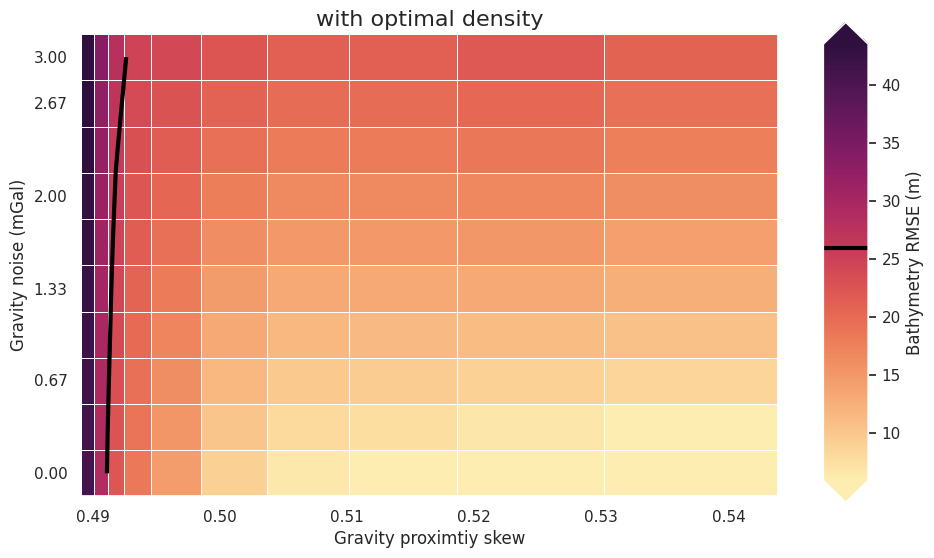

In [30]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_proximity_skew",
    y="grav_noise_levels",
    x_title="Gravity proximtiy skew",
    y_title="Gravity noise (mGal)",
    background="final_inversion_rmse",
    background_title="Bathymetry RMSE (m)",
    background_robust=True,
    plot_contours=[starting_bathymetry_rmse],
    plot_title="with optimal density",
    constrained_layout=False,
)

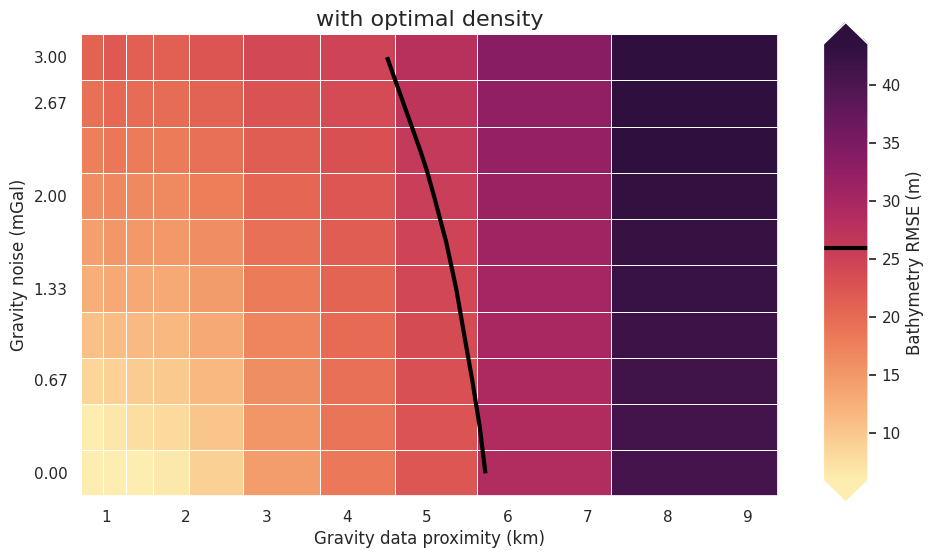

In [29]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_proximity",
    y="grav_noise_levels",
    x_title="Gravity data proximity (km)",
    y_title="Gravity noise (mGal)",
    background="final_inversion_rmse",
    background_title="Bathymetry RMSE (m)",
    background_robust=True,
    plot_contours=[starting_bathymetry_rmse],
    plot_title="with optimal density",
    constrained_layout=False,
)

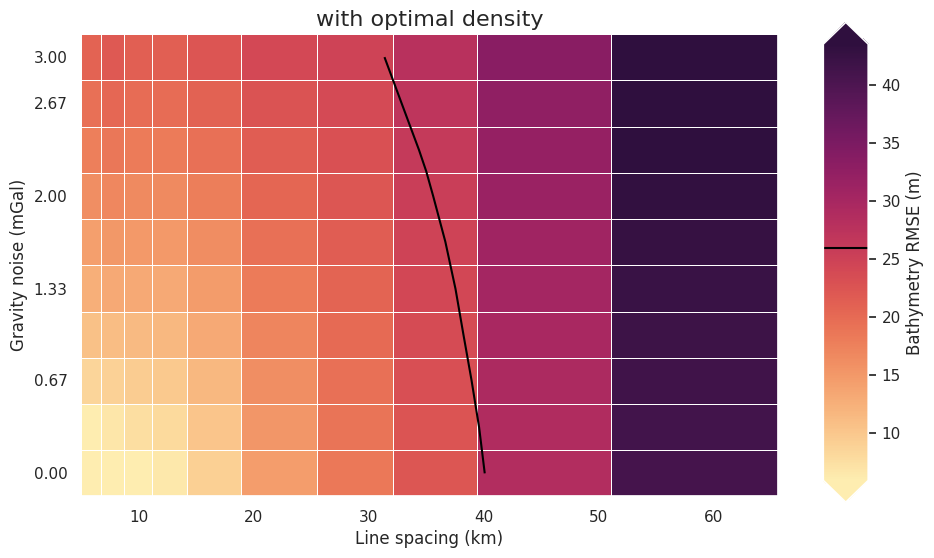

In [107]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="final_inversion_rmse",
    background_title="Bathymetry RMSE (m)",
    background_robust=True,
    plot_contours=[starting_bathymetry_rmse],
    plot_title="with optimal density",
    constrained_layout=False,
)

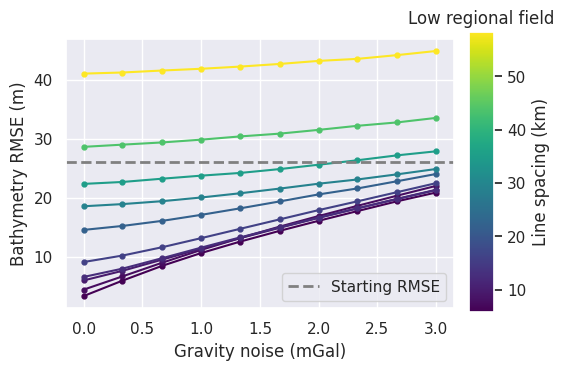

In [108]:
_ = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    y="final_inversion_rmse",
    x="grav_noise_levels",
    groupby_col="grav_line_spacing",
    x_label="Gravity noise (mGal)",
    cbar_label="Line spacing (km)",
    trend_line=True,
    horizontal_line=starting_bathymetry_rmse,
    horizontal_line_label="Starting RMSE",
    horizontal_line_label_loc="lower right",
    plot_title="Low regional field",
)

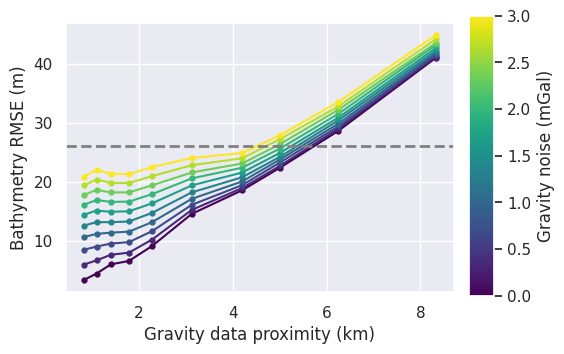

In [109]:
x = "grav_proximity"
fig = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    x=x,
    x_label="Gravity data proximity (km)",
    y="final_inversion_rmse",
    y_label="Bathymetry RMSE (m)",
    groupby_col="grav_noise_levels",
    cbar_label="Gravity noise (mGal)",
    horizontal_line=starting_bathymetry_rmse,
)

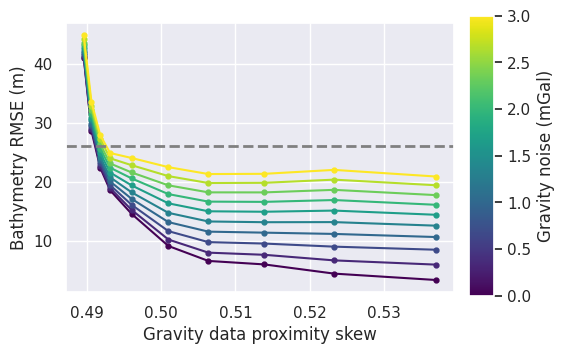

In [31]:
x = "grav_proximity_skew"
fig = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    x=x,
    x_label="Gravity proximity skew",
    y="final_inversion_rmse",
    y_label="Bathymetry RMSE (m)",
    groupby_col="grav_noise_levels",
    cbar_label="Gravity noise (mGal)",
    horizontal_line=starting_bathymetry_rmse,
)